# <center>**AISC2007 - Deep Learning - Group Assignement 3**</center>
Group Name : Group 2<br>
Question 1 : DCGAN<br>
Contributors : <br>
Girish Sai Thiruvidhula : Built and trained DCGAN model and generated images using pytorch using the given dataset<br>
Gowtham Katta : Evaluated the performance of the model using Inception Score and FID score.



## Importing the libraries

In [1]:
import zipfile
import os
import shutil
from pathlib import Path
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
import torch
from torchvision.utils import save_image
from torchvision.utils import make_grid
import torch
from torchvision.models import inception_v3
from scipy.linalg import sqrtm
from torch.nn.functional import adaptive_avg_pool2d, interpolate
from tqdm.notebook import tqdm
import torch.nn.functional as F
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torch.nn as nn
from PIL import Image
import imageio
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### Extracting the images from the given ZIP file

In [2]:
path_to_zip_file = r"FaceExpressions.zip"
EXTRACT_DATA_DIR = "extractedimageFiles"

In [3]:
with zipfile.ZipFile(path_to_zip_file, 'r') as zip_ref:
    zip_ref.extractall(EXTRACT_DATA_DIR)

In [3]:
print(os.listdir(EXTRACT_DATA_DIR))
print(os.listdir(EXTRACT_DATA_DIR + "/dataset/"))

['data.csv', 'dataset']
['Angry', 'Happy', 'Neutral', 'Sad', 'Surprise']


#### Listing the directories from the extracted ZIP file

In [6]:
subfolders = os.listdir(EXTRACT_DATA_DIR + "/dataset/")
if subfolders.__contains__("Ahegao"):
    shutil.rmtree(EXTRACT_DATA_DIR + "/dataset/Ahegao")
else:
    os.listdir(EXTRACT_DATA_DIR + "/dataset/")

* Removing the unwanted class from the extracted data.

In [4]:
print(os.listdir(EXTRACT_DATA_DIR + "/dataset/"))
DATA_DIR = EXTRACT_DATA_DIR + "/dataset/"

['Angry', 'Happy', 'Neutral', 'Sad', 'Surprise']


* Checking the directires after the deleteing the unwanted class.

In [5]:
# method to walk thorugh the given root diretory to check the sub folders and images in the subfolders.
def walk_through_dir(dir_path):
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

In [6]:
walk_through_dir(DATA_DIR)

There are 5 directories and 0 images in 'extractedimageFiles/dataset/'.
There are 0 directories and 1313 images in 'extractedimageFiles/dataset/Angry'.
There are 0 directories and 3740 images in 'extractedimageFiles/dataset/Happy'.
There are 0 directories and 4027 images in 'extractedimageFiles/dataset/Neutral'.
There are 0 directories and 3934 images in 'extractedimageFiles/dataset/Sad'.
There are 0 directories and 1234 images in 'extractedimageFiles/dataset/Surprise'.


In [10]:
os.makedirs("inputimageFiles/", exist_ok=False)
os.makedirs("inputimageFiles/Angry/", exist_ok=False)
os.makedirs("inputimageFiles/Angry/images", exist_ok=False)
os.makedirs("inputimageFiles/Happy/", exist_ok=False)
os.makedirs("inputimageFiles/Happy/images", exist_ok=False)
os.makedirs("inputimageFiles/Neutral/", exist_ok=False)
os.makedirs("inputimageFiles/Neutral/images", exist_ok=False)
os.makedirs("inputimageFiles/Sad/", exist_ok=False)
os.makedirs("inputimageFiles/Sad/images", exist_ok=False)
os.makedirs("inputimageFiles/Surprise/", exist_ok=False)
os.makedirs("inputimageFiles/Surprise/images", exist_ok=False)

In [7]:
for filename in os.listdir("extractedimageFiles/dataset/Happy"):
    # Check if the file is a regular file (not a directory)
    if os.path.isfile(os.path.join("extractedimageFiles/dataset/Happy", filename)):
        # Copy the file from source to destination directory
        shutil.copy(os.path.join("extractedimageFiles/dataset/Happy", filename), "inputimageFiles/Happy/images")

In [8]:
class_labels = os.listdir(DATA_DIR)
class_labels

['Angry', 'Happy', 'Neutral', 'Sad', 'Surprise']

In [9]:
image_size = 64 # size of the image in pixels to crop the image in the dataset folder
batch_size = 128 # size of the batch
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5) # mean and standard deviation of 0.5 to normalize the images of 3 channels in the range of -1 to 1 

* PyTorch uses ImageFolder function to read the images from a directory

In [10]:
angry_ds = ImageFolder("inputimageFiles/Happy/", transform=T.Compose([ # used to perfrom several image operations together in one go
    T.Resize(image_size), # resize images to 64 pixel
    T.CenterCrop(image_size), # crop the images from center according to the given size
    T.ToTensor(),  # convert images to tensors
    T.Normalize(*stats)])) # normalize the images to mean and standard deviation
 
angry_dl = DataLoader(angry_ds, batch_size, shuffle=True, num_workers=3, pin_memory=True) # Dataloader that provides an easy way to load batches of data from a dataset

## Axuallary Functions to denormalize the image tensors and display some sample images from a batch.

In [11]:
def denorm(img_tensors): # bringing back the normalized images to original form
    return img_tensors * stats[1][0] + stats[0][0] 

In [12]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8)) # make a grid of 8*8
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64): # maximum number of images to show in grid
    for images, _ in dl:
        show_images(images, nmax)
        break

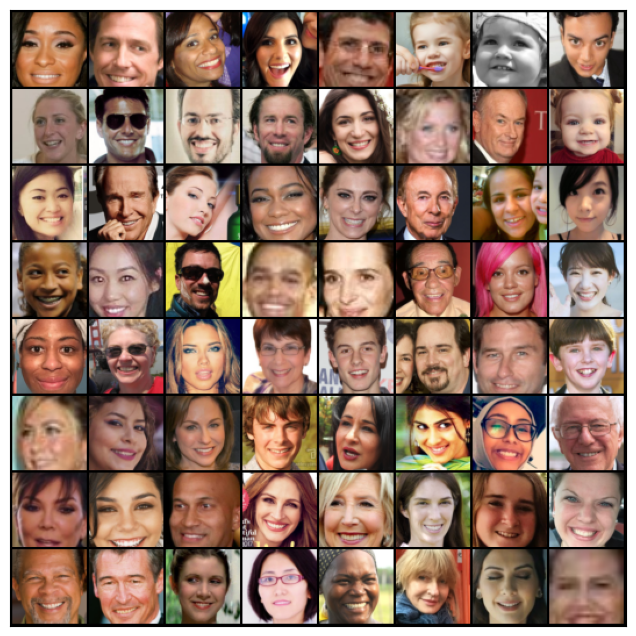

In [13]:
show_batch(angry_dl)

* Above grid displays the images from all the 5 classes Angry, Happy,neutral, Sad, Suprise.

In [14]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    # Move the dataloader data to a gpu
    def __init__(self, dl, device): 
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        for b in self.dl: # Yield a batch of data after moving it to device
            yield to_device(b, self.device)

    def __len__(self):
        # Number of batches
        return len(self.dl)

In [15]:
device = get_default_device()
device

device(type='cpu')

In [16]:
angry_dl = DeviceDataLoader(angry_dl, device)

In [17]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),

    nn.Flatten(),
    nn.Sigmoid())

In [18]:
discriminator = to_device(discriminator, device) # creating the discriminator object

In [19]:
latent_size = 128 # defining number of latent dimensions

In [20]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh() # output is tanh because our output ranges from -1 to 1
    # out: 3 x 64 x 64
)

In [21]:
generator = to_device(generator, device)

torch.Size([128, 3, 64, 64])


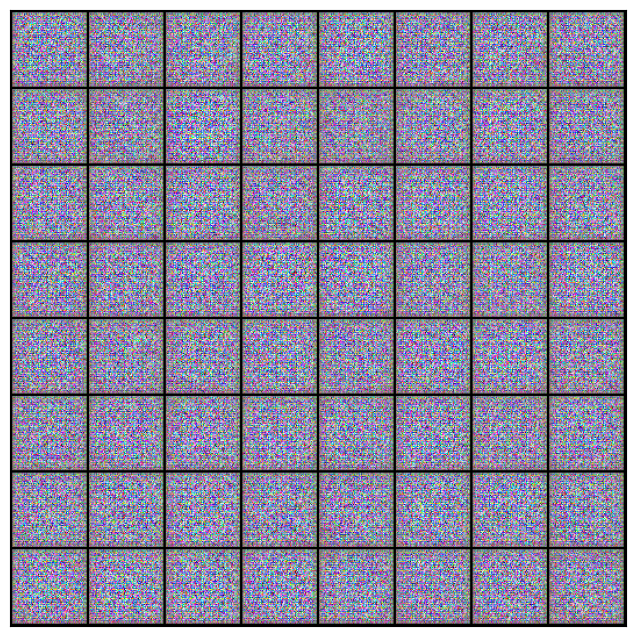

In [22]:
ran_tensors = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
fake_images = generator(ran_tensors)
print(fake_images.shape)
show_images(fake_images)

* At the start of the training the generator image is like above, it is a random noise at it didn't anything yet(no training happend yet).

In [23]:
def discriminator_training(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

In [24]:
def generator_training(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [36]:
sample_dir = class_labels[1] + 'generated'
os.makedirs(sample_dir, exist_ok=True)

* Folder to save images during trainging.

In [37]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

* Functiontion to save images in the form of 8*8 matrix.

In [38]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving generated-images-0000.png


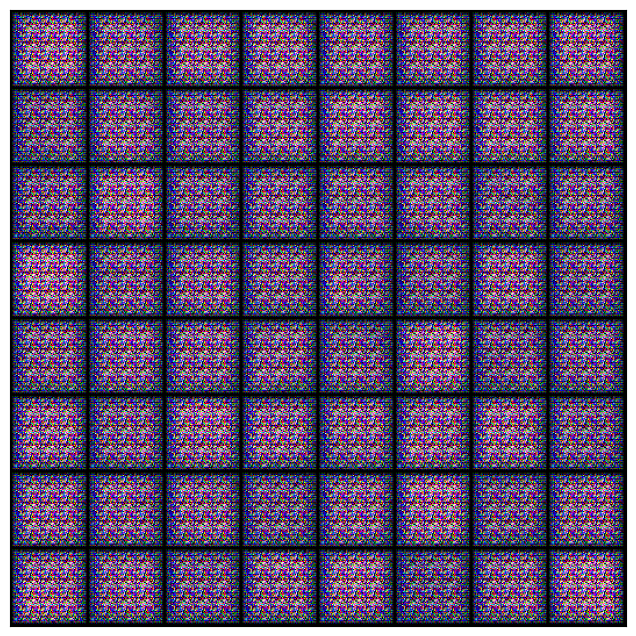

In [39]:
save_samples(0, fixed_latent)

### Helper functions to perform model evaluation

In [40]:
# Function to preprocess images and calculate features
def get_inception_features(images, model):
    # Preprocess images
    images = interpolate(images, size=(299, 299), mode='bilinear', align_corners=True)
    # Normalize to [-1, 1]
    images = (images - 0.5) * 2
    # Get features
    with torch.no_grad():
        features = model(images)
    return features

In [41]:
# Inception Score (IS) function
def calculate_inception_score(features):
    # Compute the softmax predictions
    softmax_preds = torch.nn.functional.softmax(features, dim=1)
    # Compute the marginal distribution
    marginal_dist = torch.mean(softmax_preds, dim=0)
    # Compute the KL divergence and inception score
    kl_divergence = softmax_preds * (torch.log(softmax_preds) - torch.log(marginal_dist))
    kl_divergence = torch.mean(torch.sum(kl_divergence, dim=1))
    inception_score = torch.exp(kl_divergence).item()
    return inception_score

In [42]:
# FID function
def calculate_fid(real_feats, fake_feats):
    # Calculate mean and covariance
    mu1, sigma1 = real_feats.mean(dim=0), torch.cov(real_feats.t())
    mu2, sigma2 = fake_feats.mean(dim=0), torch.cov(fake_feats.t())
    # Calculate FID
    ssdiff = torch.sum((mu1 - mu2) ** 2)
    covmean = sqrtm(sigma1.mm(sigma2).cpu().numpy())
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    fid_score = ssdiff + torch.trace(sigma1 + sigma2 - 2 * torch.tensor(covmean))
    return fid_score.item()

In [43]:
# Load Inception model
inception_model = inception_v3(pretrained=True)
inception_model.fc = torch.nn.Identity()  # Remove the last fully connected layer
inception_model.to(device)
inception_model.eval()

Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

## **Training the DCGAN model**

In [44]:
def model_fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    for epoch in range(epochs):
        for real_images, _ in tqdm(angry_dl):
            # Train discriminator
            loss_d, real_score, fake_score = discriminator_training(real_images, opt_d)
            # Train generator
            loss_g = generator_training(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)
    
    return losses_g, losses_d, real_scores, fake_scores

In [47]:
learning_rate = 0.001
epochs = 10

In [48]:
history = model_fit(epochs, learning_rate)

  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [1/10], loss_g: 3.8327, loss_d: 0.0973, real_score: 0.9742, fake_score: 0.0664
Saving generated-images-0001.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [2/10], loss_g: 4.2287, loss_d: 0.1375, real_score: 0.9758, fake_score: 0.1021
Saving generated-images-0002.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [3/10], loss_g: 6.4579, loss_d: 0.9158, real_score: 0.8762, fake_score: 0.4678
Saving generated-images-0003.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [4/10], loss_g: 7.6566, loss_d: 0.7722, real_score: 0.9040, fake_score: 0.3927
Saving generated-images-0004.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [5/10], loss_g: 3.4856, loss_d: 0.7742, real_score: 0.6552, fake_score: 0.1720
Saving generated-images-0005.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [6/10], loss_g: 4.0125, loss_d: 1.3396, real_score: 0.9183, fake_score: 0.4196
Saving generated-images-0006.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [7/10], loss_g: 10.4481, loss_d: 2.4508, real_score: 0.9984, fake_score: 0.8757
Saving generated-images-0007.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [8/10], loss_g: 5.5117, loss_d: 1.2754, real_score: 0.9602, fake_score: 0.6257
Saving generated-images-0008.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [9/10], loss_g: 2.4424, loss_d: 0.3190, real_score: 0.9484, fake_score: 0.2120
Saving generated-images-0009.png


  0%|          | 0/30 [00:00<?, ?it/s]

Epoch [10/10], loss_g: 5.7192, loss_d: 1.2615, real_score: 0.3982, fake_score: 0.0037
Saving generated-images-0010.png


In [49]:
losses_g, losses_d, real_scores, fake_scores = history

In [50]:
# Save the model checkpoints 
torch.save(generator.state_dict(), 'G_ch.pth')
torch.save(discriminator.state_dict(), 'D_ch.pth')

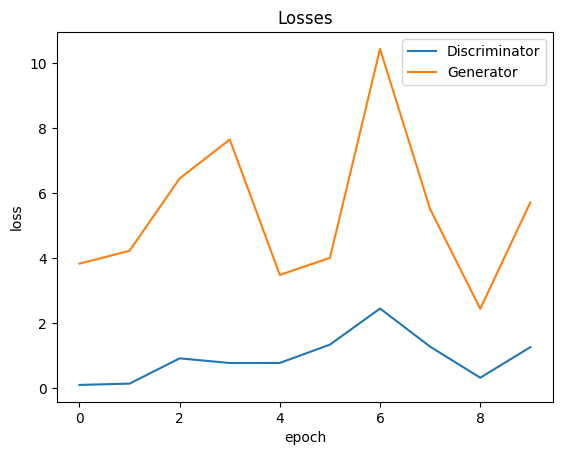

In [51]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

* From the above plot, we can see that the discriminator loss is not high except from the 16 to 18 epoch but it has gone down after it.
* Generator loss kept fluctuating and might reach to the level of dicriminator if we increase the training for more epochs.

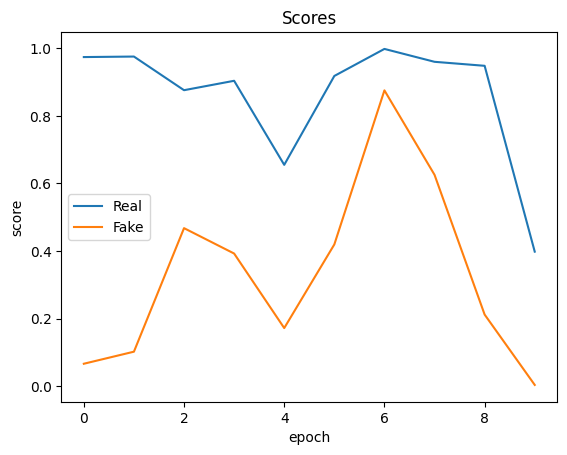

In [52]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

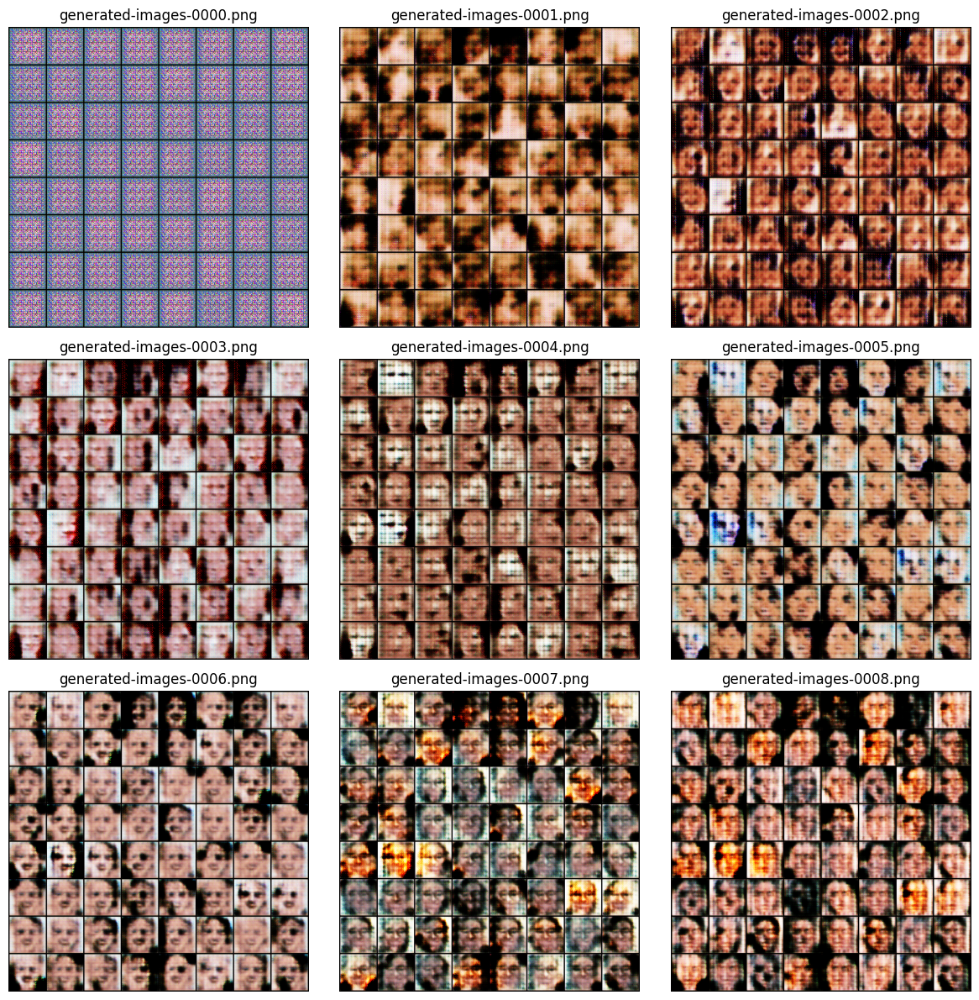

In [55]:
image_files = os.listdir(sample_dir)
num_rows=3
num_cols=3
num_images = len(image_files)
if num_images < num_rows * num_cols:
    print("Not enough images in the folder to fill the grid.")

# Plot images in a grid
fig, axes = plt.subplots(num_rows, num_cols, figsize=(num_cols * 4, num_rows * 4))
axes = axes.ravel()

for i in range(num_rows * num_cols):
    image_path = os.path.join(sample_dir, image_files[i])
    image = plt.imread(image_path)
    axes[i].imshow(image)
    axes[i].axis('off')
    axes[i].set_title(image_files[i])

plt.tight_layout()
plt.show()

In [ ]:
import os
import imageio

def create_gif(input_folder, output_file, duration=0.5):
    images = []
    # Iterate over files in the input folder
    for filename in sorted(os.listdir(input_folder)):
        filepath = os.path.join(input_folder, filename)
        # Check if the file is a regular file (not a directory) and has a valid image extension
        if os.path.isfile(filepath) and filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif')):
            images.append(imageio.imread(filepath))
    # Save images as a GIF
    imageio.mimsave(output_file, images, duration=duration)

# Example usage
output_file = 'Happy.gif'
create_gif(sample_dir, output_file)


C:\Users\giris\AppData\Local\Temp\ipykernel_15184\873732413.py:11: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  images.append(imageio.imread(filepath))


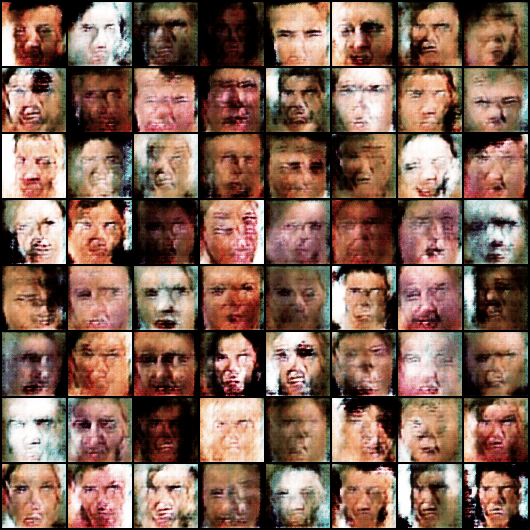

In [ ]:
from IPython.display import Image

Image(filename='Happy.gif')

In [56]:
# Save the entire models
torch.save(generator, 'Happy_generator_model.pth')
torch.save(discriminator, 'Happy_discriminator_model.pth')


## Model Evaluation

In [57]:
# Get a batch of real images from the DataLoader
real_images, _ = next(iter(angry_dl))
real_images = real_images.to(device)

In [58]:
fake_images = generator(fixed_latent).to(device)

In [59]:
# Calculate features for real and fake images
real_features = get_inception_features(real_images, inception_model)
fake_features = get_inception_features(fake_images, inception_model)

In [60]:
# Calculated scores
inception_score = calculate_inception_score(fake_features)
fid_score = calculate_fid(real_features, fake_features)

print(f'Inception Score: {inception_score}')
print(f'FID Score: {fid_score}')

Inception Score: 1.0457950830459595
FID Score: 316.4177551269531


In [61]:
from PIL import Image

# Load the grid of generated images
grid_image = Image.open(sample_dir + "/generated-images-0020.png")

# Reshape the grid into a list of images
num_images = 64  # Assuming 8x8 grid
image_size = 299  # Size expected by Inception model
images = []
for i in range(num_images):
    x = i % 8 * image_size
    y = i // 8 * image_size
    image = grid_image.crop((x, y, x + image_size, y + image_size))
    images.append(image)

# Resize and normalize the images
inception_model_transform = transforms.Compose([
    transforms.Resize((299, 299)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])
normalized_images = [inception_model_transform(image) for image in images]
fake_images_gen = torch.stack(normalized_images)

# Load real images using the dataloader
real_images_gen = next(iter(angry_dl))[0].to(device)

# Calculate Inception Score
# Calculate features for real and fake images
real_features = get_inception_features(real_images_gen, inception_model)
fake_features = get_inception_features(fake_images_gen, inception_model)

# Calculated scores
inception_score = calculate_inception_score(fake_features)
fid_score = calculate_fid(real_features, fake_features)

print(f'Inception Score: {inception_score}')
print(f'FID Score: {fid_score}')


FileNotFoundError: [Errno 2] No such file or directory: 'Happygenerated/generated-images-0020.png'